In [1]:
import pm4py
from pm4py.objects.log.importer.xes import importer as xes_importer
from pm4py.objects.log.obj import EventLog, Trace, Event

In [2]:
log = xes_importer.apply("C:/Users/Simone/Desktop/UNIVERSITA/MAGISTRALE/BIOMEDICAL DECISION SUPPORT SYSTEM/Assignments/2/log-10-percent-noise.xes.gz")

parsing log, completed traces ::   0%|          | 0/100000 [00:00<?, ?it/s]

In [3]:
log

[{'attributes': {'concept:name': '1'}, 'events': [{'concept:name': 'Triage', 'lifecycle:transition': 'complete', 'priority': 'red', 'time:timestamp': datetime.datetime(1970, 1, 1, 1, 0, tzinfo=datetime.timezone.utc)}, '..', {'concept:name': 'Prepare', 'lifecycle:transition': 'complete', 'time:timestamp': datetime.datetime(1970, 1, 1, 2, 31, tzinfo=datetime.timezone.utc)}]}, '....', {'attributes': {'concept:name': '99999'}, 'events': [{'concept:name': 'Triage', 'lifecycle:transition': 'complete', 'priority': 'orange', 'time:timestamp': datetime.datetime(1987, 2, 7, 18, 16, tzinfo=datetime.timezone.utc)}, '..', {'concept:name': 'Prepare', 'lifecycle:transition': 'complete', 'time:timestamp': datetime.datetime(1987, 2, 7, 20, 9, tzinfo=datetime.timezone.utc)}]}]

In [4]:
#loga = [trace for trace in log if trace[-1]['concept:name'] == 'Release B']

test_log = log[10:]
train_log = log[0:10]


def create_event_log(traces_list):
    log = EventLog()
    
    for trace_data in traces_list:
        trace = Trace()
        
        for event_data in trace_data[:-1]:
            event = Event(event_data)
            trace.append(event)
        
        log.append(trace)
    
    return log

In [5]:
for e in test_log[0]:
    print(e['concept:name'])

Triage
Register
Check
X-Ray
Visit
Check
Final Visit
Prepare
Check


In [6]:
train = create_event_log(train_log)
test = create_event_log(test_log)

In [7]:
test

[{'attributes': {}, 'events': [{'concept:name': 'Triage', 'lifecycle:transition': 'complete', 'priority': 'green', 'time:timestamp': datetime.datetime(1971, 9, 19, 8, 14, tzinfo=datetime.timezone.utc)}, '..', {'concept:name': 'Prepare', 'lifecycle:transition': 'complete', 'time:timestamp': datetime.datetime(1971, 9, 19, 8, 53, tzinfo=datetime.timezone.utc)}]}, '....', {'attributes': {}, 'events': [{'concept:name': 'Triage', 'lifecycle:transition': 'complete', 'priority': 'orange', 'time:timestamp': datetime.datetime(1987, 2, 7, 18, 16, tzinfo=datetime.timezone.utc)}, '..', {'concept:name': 'Final Visit', 'lifecycle:transition': 'complete', 'type': 'K', 'time:timestamp': datetime.datetime(1987, 2, 7, 19, 46, tzinfo=datetime.timezone.utc)}]}]

In [8]:
net, initial_marking, final_marking = pm4py.discover_petri_net_inductive(train)

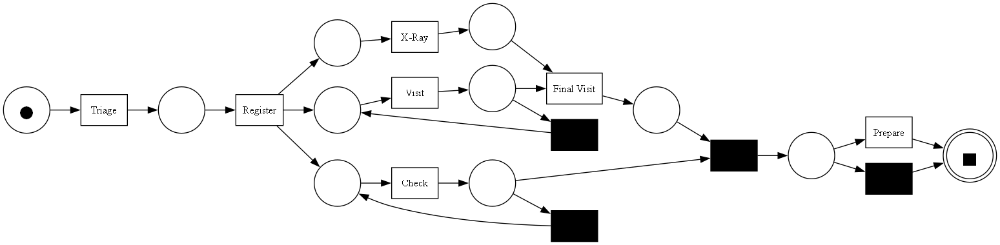

In [9]:
pm4py.view_petri_net(net, initial_marking, final_marking)

In [10]:
net

places: [ p_12, p_14, p_15, p_18, p_19, p_3, p_5, p_8, p_9, sink, source ]
transitions: [ (02c1be71-3467-4293-a998-d37ffeb073cf, 'Triage'), (200f0fd1-5858-4987-9270-5117d7a7c080, 'Visit'), (62c0e0d9-809c-4dc0-9fff-412137a8d1c6, 'Prepare'), (80ec9737-cc19-4bbe-a52f-7ed0e100f647, 'Final Visit'), (8e202d33-817e-48b5-b043-c1af8869f21c, 'Register'), (bb1b9893-33ae-45f6-a925-a8ee66f44196, 'Check'), (e7d155f4-0c58-4150-8da1-6106aa09869c, 'X-Ray'), (skip_11, None), (skip_13, None), (skip_5, None), (tauJoin_2, None) ]
arcs: [ (02c1be71-3467-4293-a998-d37ffeb073cf, 'Triage')->p_3, (200f0fd1-5858-4987-9270-5117d7a7c080, 'Visit')->p_19, (62c0e0d9-809c-4dc0-9fff-412137a8d1c6, 'Prepare')->sink, (80ec9737-cc19-4bbe-a52f-7ed0e100f647, 'Final Visit')->p_12, (8e202d33-817e-48b5-b043-c1af8869f21c, 'Register')->p_14, (8e202d33-817e-48b5-b043-c1af8869f21c, 'Register')->p_18, (8e202d33-817e-48b5-b043-c1af8869f21c, 'Register')->p_8, (bb1b9893-33ae-45f6-a925-a8ee66f44196, 'Check')->p_9, (e7d155f4-0c58-4150-8d

In [11]:
from pm4py.algo.conformance.alignments.petri_net import algorithm as alignments

# Perform alignments
aligned_traces = alignments.apply_log(test, net, initial_marking, final_marking)


aligning log, completed variants ::   0%|          | 0/1318 [00:00<?, ?it/s]

In [12]:
al = [t[1] for t in aligned_traces[0]['alignment']]

In [13]:
aligned_traces

[{'alignment': [('Triage', 'Triage'),
   ('Register', 'Register'),
   ('Check', 'Check'),
   ('>>', None),
   ('X-Ray', 'X-Ray'),
   ('Visit', 'Visit'),
   ('Check', 'Check'),
   ('Final Visit', 'Final Visit'),
   ('>>', None),
   ('Prepare', 'Prepare')],
  'cost': 2,
  'visited_states': 10,
  'queued_states': 41,
  'traversed_arcs': 42,
  'lp_solved': 1,
  'fitness': 1.0,
  'bwc': 140002},
 {'alignment': [('Triage', 'Triage'),
   ('Register', 'Register'),
   ('X-Ray', 'X-Ray'),
   ('Check', 'Check'),
   ('>>', None),
   ('Visit', 'Visit'),
   ('Check', 'Check'),
   ('Final Visit', 'Final Visit'),
   ('>>', None),
   ('Prepare', 'Prepare')],
  'cost': 2,
  'visited_states': 10,
  'queued_states': 39,
  'traversed_arcs': 40,
  'lp_solved': 3,
  'fitness': 1.0,
  'bwc': 140002},
 {'alignment': [('Triage', 'Triage'),
   ('Register', 'Register'),
   ('X-Ray', 'X-Ray'),
   ('Check', 'Check'),
   ('>>', None),
   ('Check', 'Check'),
   ('Visit', 'Visit'),
   ('Final Visit', 'Final Visit'),
 

In [14]:
from pm4py.objects.petri_net import semantics


In [15]:
semantics.enabled_transitions(net, initial_marking)

{(02c1be71-3467-4293-a998-d37ffeb073cf, 'Triage')}

In [16]:
current_marking = initial_marking

In [17]:
trs = list(semantics.enabled_transitions(net, current_marking))

In [18]:
trs

[(02c1be71-3467-4293-a998-d37ffeb073cf, 'Triage')]

In [19]:
current_marking

['source:1']

In [20]:
current_marking = semantics.execute(trs[0], net,  current_marking)

In [21]:
current_marking

['p_3:1']

In [22]:
semantics.enabled_transitions(net, current_marking)

{(8e202d33-817e-48b5-b043-c1af8869f21c, 'Register')}

In [23]:
for aligned_trace in aligned_traces:
    print(aligned_trace['alignment'])

# (log_step, model_step)    

[('Triage', 'Triage'), ('Register', 'Register'), ('Check', 'Check'), ('>>', None), ('X-Ray', 'X-Ray'), ('Visit', 'Visit'), ('Check', 'Check'), ('Final Visit', 'Final Visit'), ('>>', None), ('Prepare', 'Prepare')]
[('Triage', 'Triage'), ('Register', 'Register'), ('X-Ray', 'X-Ray'), ('Check', 'Check'), ('>>', None), ('Visit', 'Visit'), ('Check', 'Check'), ('Final Visit', 'Final Visit'), ('>>', None), ('Prepare', 'Prepare')]
[('Triage', 'Triage'), ('Register', 'Register'), ('X-Ray', 'X-Ray'), ('Check', 'Check'), ('>>', None), ('Check', 'Check'), ('Visit', 'Visit'), ('Final Visit', 'Final Visit'), ('>>', None), ('>>', None)]
[('Triage', 'Triage'), ('Register', 'Register'), ('Check', 'Check'), ('>>', None), ('X-Ray', 'X-Ray'), ('Visit', 'Visit'), ('Final Visit', 'Final Visit'), ('Check', 'Check'), ('>>', None), ('>>', None)]
[('Triage', 'Triage'), ('Register', 'Register'), ('Check', 'Check'), ('>>', None), ('X-Ray', 'X-Ray'), ('Check', 'Check'), ('>>', None), ('Visit', 'Visit'), ('Check', '

In [24]:
worst  = min(aligned_traces, key=lambda x: x['fitness'])

In [25]:
worst['alignment']

[('Triage', 'Triage'),
 ('>>', 'Register'),
 ('>>', 'Check'),
 ('>>', 'X-Ray'),
 ('>>', 'Visit'),
 ('>>', 'Final Visit'),
 ('>>', None),
 ('>>', None)]

In [26]:
test[aligned_traces.index(worst)]

{'attributes': {}, 'events': [{'concept:name': 'Triage', 'lifecycle:transition': 'complete', 'priority': 'white', 'time:timestamp': datetime.datetime(1971, 9, 26, 16, 16, tzinfo=datetime.timezone.utc)}]}

In [27]:
aligned_traces[1]['alignment']

[('Triage', 'Triage'),
 ('Register', 'Register'),
 ('X-Ray', 'X-Ray'),
 ('Check', 'Check'),
 ('>>', None),
 ('Visit', 'Visit'),
 ('Check', 'Check'),
 ('Final Visit', 'Final Visit'),
 ('>>', None),
 ('Prepare', 'Prepare')]

In [28]:
from pm4py.algo.conformance.alignments.petri_net.algorithm import apply_trace

apply_trace(test[aligned_traces.index(worst)], net, initial_marking, final_marking, parameters = {
    "ret_tuple_as_trans_desc": True})

{'alignment': [(('t_Triage_0', '02c1be71-3467-4293-a998-d37ffeb073cf'),
   ('Triage', 'Triage')),
  (('>>', '8e202d33-817e-48b5-b043-c1af8869f21c'), ('>>', 'Register')),
  (('>>', 'bb1b9893-33ae-45f6-a925-a8ee66f44196'), ('>>', 'Check')),
  (('>>', 'e7d155f4-0c58-4150-8da1-6106aa09869c'), ('>>', 'X-Ray')),
  (('>>', '200f0fd1-5858-4987-9270-5117d7a7c080'), ('>>', 'Visit')),
  (('>>', '80ec9737-cc19-4bbe-a52f-7ed0e100f647'), ('>>', 'Final Visit')),
  (('>>', 'tauJoin_2'), ('>>', None)),
  (('>>', 'skip_13'), ('>>', None))],
 'cost': 50002,
 'visited_states': 8,
 'queued_states': 17,
 'traversed_arcs': 19,
 'lp_solved': 2,
 'fitness': 0.2857142857142857,
 'bwc': 70002}

In [29]:
type(net)

pm4py.objects.petri_net.obj.PetriNet

In [30]:
import pm4py
from pm4py.algo.evaluation.precision import algorithm as precision_evaluator
from pm4py.algo.discovery.alpha import algorithm as alpha_miner
from pm4py.algo.conformance.alignments.petri_net import algorithm as alignments
from pm4py.objects.conversion.log import converter as log_converter

def calculate_precision_metrics(event_log, petri_net=None, initial_marking=None, final_marking=None):
    """
    Calculate different precision metrics for a process model against an event log.
    If no model is provided, discovers one using Alpha Miner.
    
    Parameters:
    event_log: Event log to evaluate
    petri_net: Optional pre-existing Petri net
    initial_marking: Optional initial marking for the Petri net
    final_marking: Optional final marking for the Petri net
    
    Returns:
    dict: Dictionary containing different precision metrics
    """
    # Convert to event log if needed
    if type(event_log) is not pm4py.objects.log.obj.EventLog:
        event_log = log_converter.apply(event_log)
    
    # If no model provided, discover one using Alpha Miner
    if petri_net is None:
        petri_net, initial_marking, final_marking = alpha_miner.apply(event_log)
    
    # Calculate ETConformance precision
    etc_precision = precision_evaluator.apply(event_log, petri_net, 
                                            initial_marking, final_marking,
                                            variant=precision_evaluator.Variants.ETCONFORMANCE_TOKEN)
    
    # Calculate Align-ETConformance precision
    aligned_precision = precision_evaluator.apply(event_log, petri_net,
                                                initial_marking, final_marking,
                                                variant=precision_evaluator.Variants.ALIGN_ETCONFORMANCE)
    
    return {
        'etconformance_precision': etc_precision,
        'align_etconformance_precision': aligned_precision
    }

def evaluate_model_quality(event_log, petri_net=None, initial_marking=None, final_marking=None):
    """
    Comprehensive evaluation of a process model including precision and fitness.
    
    Parameters:
    event_log: Event log to evaluate
    petri_net: Optional pre-existing Petri net
    initial_marking: Optional initial marking for the Petri net
    final_marking: Optional final marking for the Petri net
    
    Returns:
    dict: Dictionary containing various quality metrics
    """
    # Convert to event log if needed
    if type(event_log) is not pm4py.objects.log.obj.EventLog:
        event_log = log_converter.apply(event_log)
    
    # If no model provided, discover one using Alpha Miner
    if petri_net is None:
        petri_net, initial_marking, final_marking = alpha_miner.apply(event_log)
    
    # Calculate precision metrics
    precision_metrics = calculate_precision_metrics(event_log, petri_net, 
                                                 initial_marking, final_marking)
    
    # Calculate alignment-based fitness
    fitness_result = alignments.apply(event_log, petri_net, 
                                    initial_marking, final_marking)
    
    avg_fitness = sum(case['fitness'] for case in fitness_result) / len(fitness_result)
    
    return {
        'precision_metrics': precision_metrics,
        'average_fitness': avg_fitness,
        'f1_score': 2 * (avg_fitness * precision_metrics['etconformance_precision']) / 
                   (avg_fitness + precision_metrics['etconformance_precision'])
    }

In [31]:
evaluate_model_quality(test, net, initial_marking, final_marking)

replaying log with TBR, completed traces ::   0%|          | 0/1331 [00:00<?, ?it/s]

computing precision with alignments, completed variants ::   0%|          | 0/1331 [00:00<?, ?it/s]

aligning log, completed variants ::   0%|          | 0/1318 [00:00<?, ?it/s]

{'precision_metrics': {'etconformance_precision': 0.9915254870474153,
  'align_etconformance_precision': 0.9919831986168443},
 'average_fitness': 0.9830462081976595,
 'f1_score': 0.9872676416060161}

In [32]:
from pm4py.objects.petri_net.obj import PetriNet, Marking
from pm4py.visualization.petri_net import visualizer

# Assuming you already have:
# - a Petri net (net)
# - a current marking (current_marking)

print("Current marking:")
for place, tokens in current_marking.items():
    print(f"Place {place.name}: {tokens} token(s)")

parameters = {"format": "png"}
gviz = visualizer.apply(net, initial_marking, parameters=parameters)
visualizer.save(gviz, "current_state.png")



Current marking:
Place p_3: 1 token(s)


''

In [33]:
t= list(semantics.enabled_transitions(net, initial_marking))[0]

In [34]:
current_marking = semantics.execute(t, net,  initial_marking)
gviz = visualizer.apply(net, current_marking, parameters=parameters)
visualizer.save(gviz, "current_state2.png")

''